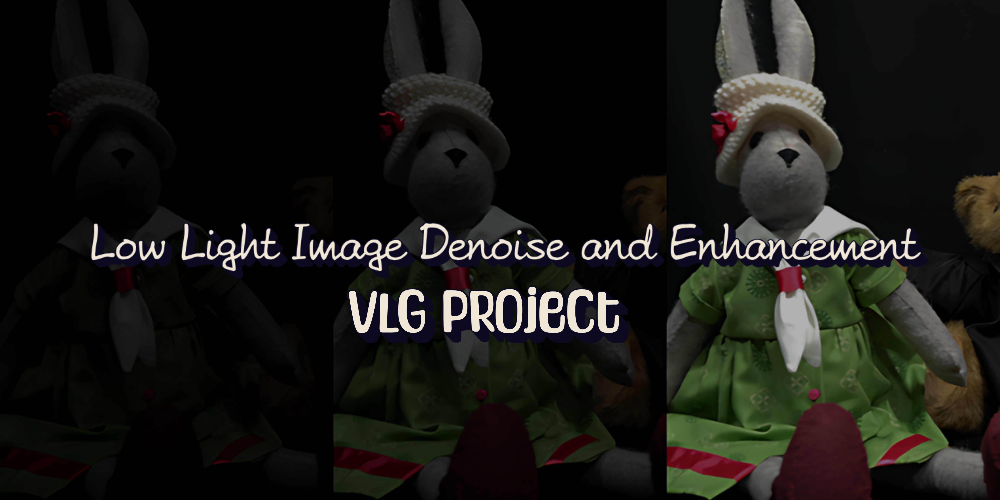

# ***Importing Libraries***

In [1]:
import os
from glob import glob
from PIL import Image, ImageOps
import random
import numpy as np
import matplotlib.pyplot as plt
from tensorflow import keras
import tensorflow as tf
from tensorflow.keras import layers

2024-06-18 12:04:22.448120: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-18 12:04:22.448255: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-18 12:04:22.562458: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
import os
for dirname, _, filenames in os.walk('/kaggle/input/lol-dataset'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/lol-dataset/lol_dataset/eval15/low/780.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/778.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/493.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/669.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/547.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/55.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/1.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/748.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/22.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/146.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/179.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/665.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/23.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/111.png
/kaggle/input/lol-dataset/lol_dataset/eval15/low/79.png
/kaggle/input/lol-dataset/lol_dataset/eval15/high/780.png
/kaggle/input/lol-dataset/lol_dataset/eval15/high/778.png
/kaggle/input/lol-dataset/lol_datas

# ***Defining necessary Image size, Batch_size and No of images to be trained***

In [3]:
IMAGE_SIZE = 256
BATCH_SIZE = 64
NO_OF_TRAIN_IMAGES = 350

In [4]:
train_low_light_images = sorted(glob("/kaggle/input/lol-dataset/lol_dataset/our485/low/*"))[:NO_OF_TRAIN_IMAGES]
val_low_light_images = sorted(glob("/kaggle/input/lol-dataset/lol_dataset/our485/low/*"))[NO_OF_TRAIN_IMAGES:450]
test_low_light_images = sorted(glob("/kaggle/input/lol-dataset/lol_dataset/eval15/low/*"))
test_high_light_images = sorted(glob("/kaggle/input/lol-dataset/lol_dataset/eval15/low/*"))

# *****Loading Data and Dataset*****

In [5]:
def dataset_generator(LL_images):
    dataset = tf.data.Dataset.from_tensor_slices((LL_images))
    dataset = dataset.map(load_image_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset

def load_image_data(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)
    image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    image = image / 255.0
    return image

In [6]:

train_dataset = dataset_generator(train_low_light_images)
val_dataset = dataset_generator(val_low_light_images)


# ***Building ZeroDCE Network***

[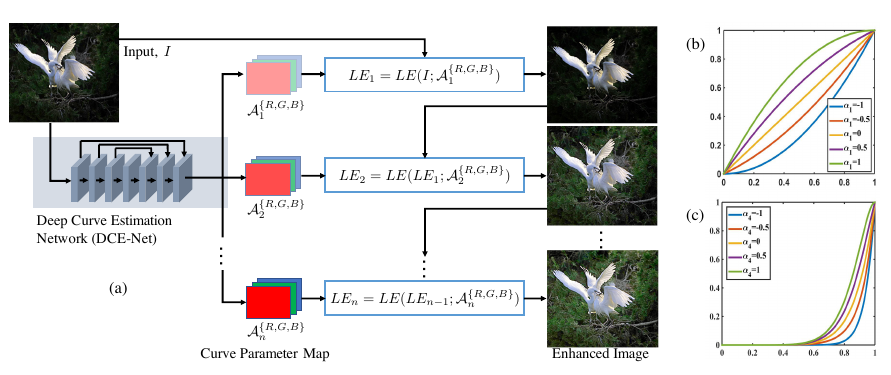](http://)

In [7]:
def DCE_nn():
    INPUT_IMAGE = keras.Input(shape=[None, None, 3])
    conv1 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(INPUT_IMAGE)
    conv2 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv1)
    conv3 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv2)
    conv4 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv3)
    int_con1 = layers.Concatenate(axis=-1)([conv4, conv3])
    conv5 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(int_con1)
    int_con2 = layers.Concatenate(axis=-1)([conv5, conv2])
    conv6 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(int_con2)
    int_con3 = layers.Concatenate(axis=-1)([conv6, conv1])
    x_r = layers.Conv2D(24, (3, 3), strides=(1, 1), activation="tanh", padding="same")(
        int_con3
    )
    return keras.Model(inputs=INPUT_IMAGE, outputs=x_r)
     

# ***Loss functions***

In [8]:
def exposure_loss(x, mean_val=0.6):
    x = tf.reduce_mean(x, axis=3, keepdims=True)
    get_mean_value = tf.nn.avg_pool2d(x, ksize=16, strides=16, padding="VALID")
    return tf.reduce_mean(tf.square(get_mean_value - mean_val))

In [9]:
def illumination_smoothness_loss(x):
    batch_size = tf.shape(x)[0]
    h_x = tf.shape(x)[1]
    w_x = tf.shape(x)[2]
    h_count = (tf.shape(x)[2] - 1) * tf.shape(x)[3]
    w_count = tf.shape(x)[2] * (tf.shape(x)[3] - 1)
    h_tv = tf.reduce_sum(tf.square((x[:, 1:, :, :] - x[:, : h_x - 1, :, :])))
    w_tv = tf.reduce_sum(tf.square((x[:, :, 1:, :] - x[:, :, : w_x - 1, :])))
    batch_size = tf.cast(batch_size, dtype=tf.float32)
    h_count = tf.cast(h_count, dtype=tf.float32)
    w_count = tf.cast(w_count, dtype=tf.float32)
    return 2 * (h_tv / h_count + w_tv / w_count) / (batch_size)

In [10]:
def color_constancy_loss(x):
    mean_rgb_value = tf.reduce_mean(x, axis=(1, 2), keepdims=True)
    mr, mg, mb = mean_rgb_value[:, :, :, 0], mean_rgb_value[:, :, :, 1], mean_rgb_value[:, :, :, 2]
    drg = tf.square(mr - mg)
    drb = tf.square(mr - mb)
    dgb = tf.square(mg - mb)
    return tf.sqrt(tf.square(drg) + tf.square(drb) + tf.square(dgb))

In [11]:
class spatial_consistency_loss(keras.losses.Loss):
    def __init__(self, **kwargs):
        super(spatial_consistency_loss, self).__init__(reduction="none")

        self.left_kernel = tf.constant(
            [[[[0, 0, 0]], [[-1, 1, 0]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.right_kernel = tf.constant(
            [[[[0, 0, 0]], [[0, 1, -1]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.up_kernel = tf.constant(
            [[[[0, -1, 0]], [[0, 1, 0]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.down_kernel = tf.constant(
            [[[[0, 0, 0]], [[0, 1, 0]], [[0, -1, 0]]]], dtype=tf.float32
        )

    def call(self, y_true, y_pred):

        mean_original = tf.reduce_mean(y_true, 3, keepdims=True)
        mean_enhanced = tf.reduce_mean(y_pred, 3, keepdims=True)

        pool_original = tf.nn.avg_pool2d(
            mean_original, ksize=4, strides=4, padding="VALID"
        )
        pool_enhanced = tf.nn.avg_pool2d(
            mean_enhanced, ksize=4, strides=4, padding="VALID"
        )

        d_left_original = tf.nn.conv2d(
            pool_original, self.left_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_left_enhanced = tf.nn.conv2d(
            pool_enhanced, self.left_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )

        d_right_original = tf.nn.conv2d(
            pool_original, self.right_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_right_enhanced = tf.nn.conv2d(
            pool_enhanced, self.right_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )

        d_up_original = tf.nn.conv2d(
            pool_original, self.up_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_up_enhanced = tf.nn.conv2d(
            pool_enhanced, self.up_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )

        d_down_original = tf.nn.conv2d(
            pool_original, self.down_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_down_enhanced = tf.nn.conv2d(
            pool_enhanced, self.down_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )

        d_left = tf.square(d_left_original - d_left_enhanced)
        d_right = tf.square(d_right_original - d_right_enhanced)
        d_up = tf.square(d_up_original - d_up_enhanced)
        d_down = tf.square(d_down_original - d_down_enhanced)
        return d_left + d_right + d_up + d_down
     

# ***Defining functions for saving, loading weights and computing losses***

In [12]:
class Zero_DCE(keras.Model):
    def __init__(self, **kwargs):
        super(Zero_DCE, self).__init__(**kwargs)
        self.dce_model = DCE_nn()

    def compile(self, learning_rate, **kwargs):
        super(Zero_DCE, self).compile(**kwargs)
        self.optimizer = keras.optimizers.Adam(learning_rate=learning_rate)
        self.spatial_constancy_loss = spatial_consistency_loss(reduction="none")

    def get_enhanced_image(self, data, out):
        r1 = out[:, :, :, :3]
        r2 = out[:, :, :, 3:6]
        r3 = out[:, :, :, 6:9]
        r4 = out[:, :, :, 9:12]
        r5 = out[:, :, :, 12:15]
        r6 = out[:, :, :, 15:18]
        r7 = out[:, :, :, 18:21]
        r8 = out[:, :, :, 21:24]
        x = data + r1 * (tf.square(data) - data)
        x = x + r2 * (tf.square(x) - x)
        x = x + r3 * (tf.square(x) - x)
        enhanced_image = x + r4 * (tf.square(x) - x)
        x = enhanced_image + r5 * (tf.square(enhanced_image) - enhanced_image)
        x = x + r6 * (tf.square(x) - x)
        x = x + r7 * (tf.square(x) - x)
        enhanced_image = x + r8 * (tf.square(x) - x)
        return enhanced_image

    def call(self, data):
        dce_net_output = self.dce_model(data)
        return self.get_enhanced_image(data, dce_net_output)

    def compute_losses(self, data, output):

        enhanced_image = self.get_enhanced_image(data, output)

        loss_illumination = 200 * illumination_smoothness_loss(output)
        loss_exposure = 10 * tf.reduce_mean(exposure_loss(enhanced_image))
        loss_color_constancy = 5 * tf.reduce_mean(color_constancy_loss(enhanced_image))
        loss_spatial_constancy = tf.reduce_mean(self.spatial_constancy_loss(enhanced_image, data))

        total_loss = (
            loss_illumination
            + loss_exposure
            + loss_color_constancy
            + loss_spatial_constancy
        )
        return {
            "Total Loss": total_loss,
            "Illumination Smoothness Loss": loss_illumination,
            "Exposure Loss": loss_exposure,
            "Color Constancy Loss": loss_color_constancy,
            "Spatial Constancy Loss": loss_spatial_constancy,
        }

    def train_step(self, data):
        with tf.GradientTape() as tape:
            output = self.dce_model(data)
            losses = self.compute_losses(data, output)
        gradients = tape.gradient(
            losses["Total Loss"], self.dce_model.trainable_weights
        )
        self.optimizer.apply_gradients(zip(gradients, self.dce_model.trainable_weights))
        return losses

    def test_step(self, data):
        output = self.dce_model(data)
        return self.compute_losses(data, output)

    def save_weights(self, filepath, overwrite=True, save_format=None, options=None):
        self.dce_model.save_weights(
            filepath, overwrite=overwrite, save_format=save_format, options=options
        )

    def load_weights(self, path, name=False, skip_mismatch=False, options=None):
        self.dce_model.load_weights(
            by_name=name,
            filepath=path,
            options=options,
            skip_mismatch=skip_mismatch,
        )
     

# ***Model Compile, Fitting***

In [13]:
DCE_model = Zero_DCE()
DCE_model.compile(learning_rate=1e-4)
history = DCE_model.fit(train_dataset, validation_data=val_dataset, epochs=100)

Epoch 1/100


2024-06-18 12:08:51.322887: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[64,32,256,256]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,64,256,256]{3,2,1,0}, f32[32,64,3,3]{3,2,1,0}, f32[32]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kRelu","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-06-18 12:08:51.960225: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.637457504s
Trying algorithm eng0{} for conv (f32[64,32,256,256]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,64,256,256]{3,2,1,0}, f32[32,64,3,3]{3,2,1,0}, f32[32]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kRelu","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2

5/5 ━━━━━━━━━━━━━━━━━━━━ 114s 1s/step - Color Constancy Loss: 0.0025 - Exposure Loss: 2.9391 - Illumination Smoothness Loss: 2.6008 - Spatial Constancy Loss: 1.4385e-05 - Total Loss: 5.5424 - val_Color Constancy Loss: 0.0013 - val_Exposure Loss: 2.9464 - val_Illumination Smoothness Loss: 3.9389 - val_Spatial Constancy Loss: 1.0953e-05 - val_Total Loss: 6.8865
Epoch 2/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 4s 863ms/step - Color Constancy Loss: 0.0025 - Exposure Loss: 2.9355 - Illumination Smoothness Loss: 2.2190 - Spatial Constancy Loss: 9.8047e-06 - Total Loss: 5.1570 - val_Color Constancy Loss: 0.0013 - val_Exposure Loss: 2.9429 - val_Illumination Smoothness Loss: 3.4312 - val_Spatial Constancy Loss: 7.2459e-06 - val_Total Loss: 6.3754
Epoch 3/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 4s 869ms/step - Color Constancy Loss: 0.0025 - Exposure Loss: 2.9316 - Illumination Smoothness Loss: 1.9468 - Spatial Constancy Loss: 5.9060e-06 - Total Loss: 4.8809 - val_Color Constancy Loss: 0.0013 - val_Exposure Loss: 2.93

# ***Visualization of Loss Function Results***

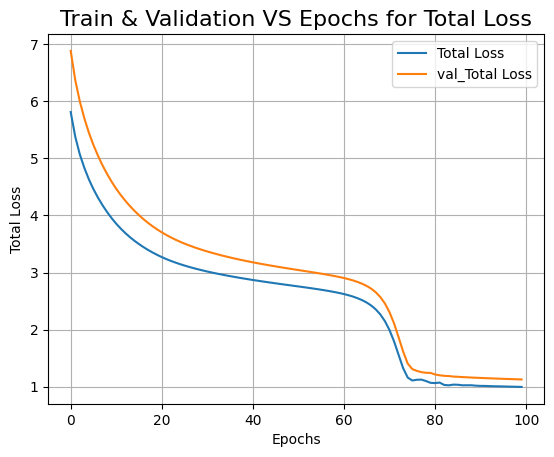

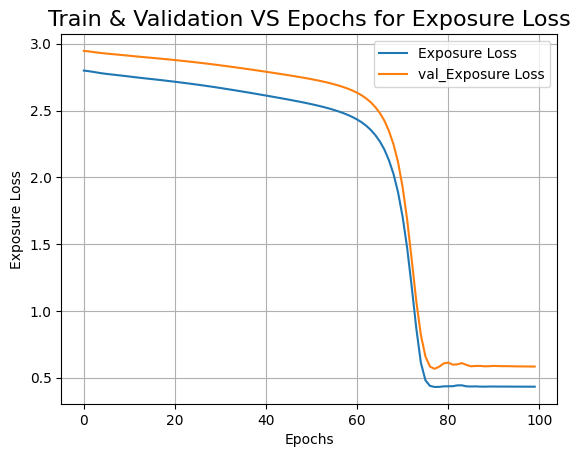

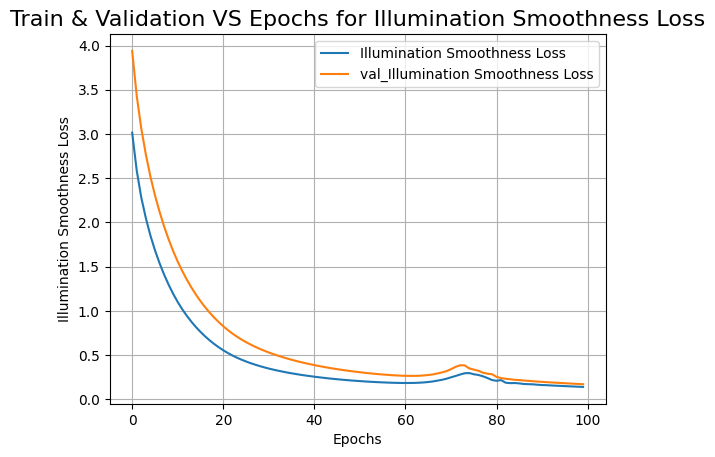

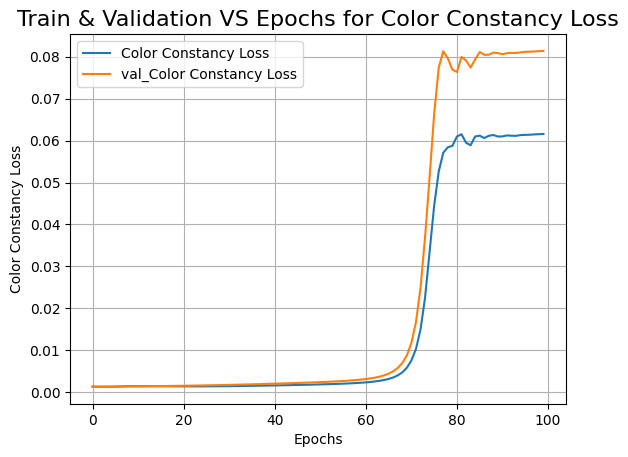

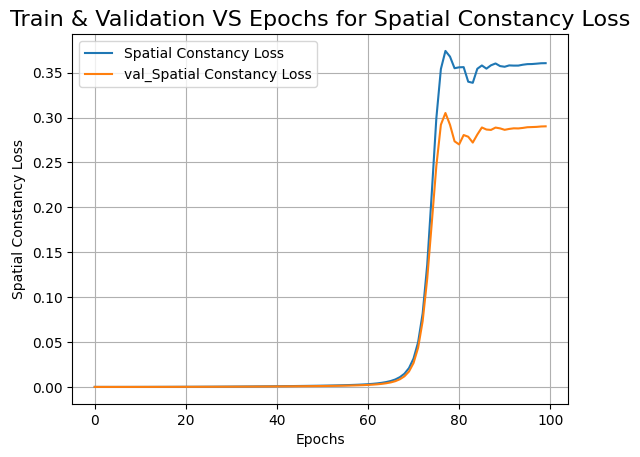

In [14]:
def plot_result(item):
    plt.plot(history.history[item], label=item)
    plt.plot(history.history["val_" + item], label="val_" + item)
    plt.xlabel("Epochs")
    plt.ylabel(item)
    plt.title("Train & Validation VS Epochs for {}".format(item), fontsize=16)
    plt.legend()
    plt.grid()
    plt.show()
    
plot_result("Total Loss")
plot_result("Exposure Loss")
plot_result("Illumination Smoothness Loss")
plot_result("Color Constancy Loss")
plot_result("Spatial Constancy Loss")

# ***Function for visualization Of Results***

In [20]:
def plot_results(images, titles, figure_size=(12, 12)):
    fig = plt.figure(figsize=figure_size)
    for i in range(len(images)):
        fig.add_subplot(1, len(images), i + 1).set_title(titles[i])
        _ = plt.imshow(images[i])
        plt.axis("off")
    plt.show()


def infer(original_image):
    input_image = keras.preprocessing.image.img_to_array(original_image)
    input_image = input_image.astype("float32") / 255.0
    input_image = np.expand_dims(input_image, axis=0)
    output_image = DCE_model(input_image)
    output_image = tf.cast((output_image[0, :, :, :] * 255), dtype=np.uint8)
    output_image = Image.fromarray(output_image.numpy())
    return output_image
     

# ***PSNR(Peak Signal To Ratio) Results***

PSNR value: 27.94433771032633 dB


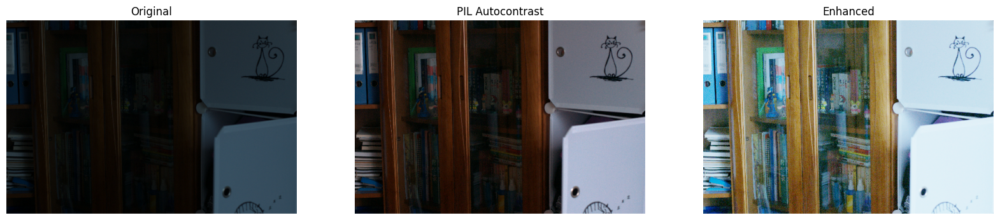

PSNR value: 27.787531732448606 dB


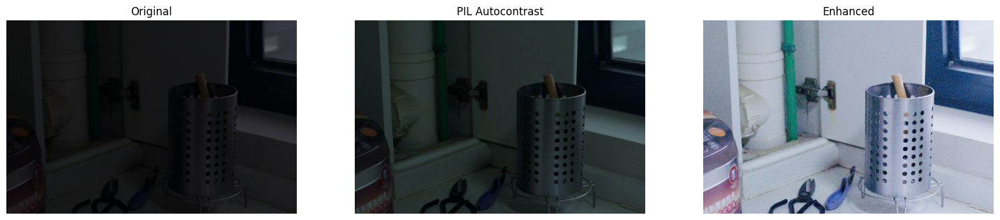

PSNR value: 27.1529408307255 dB


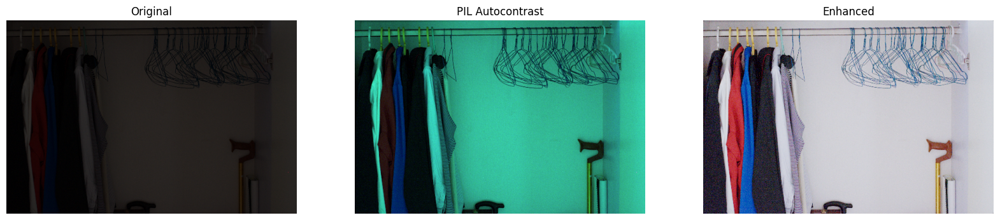

PSNR value: 27.635900201336096 dB


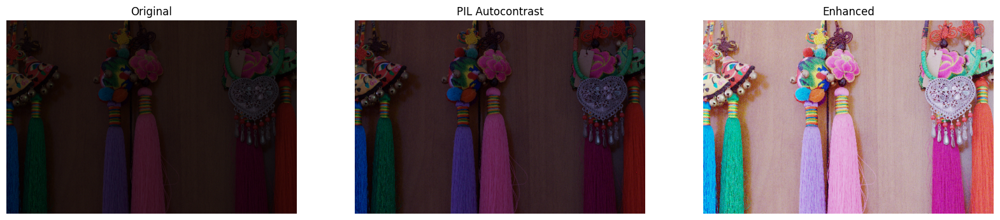

PSNR value: 27.677553279905883 dB


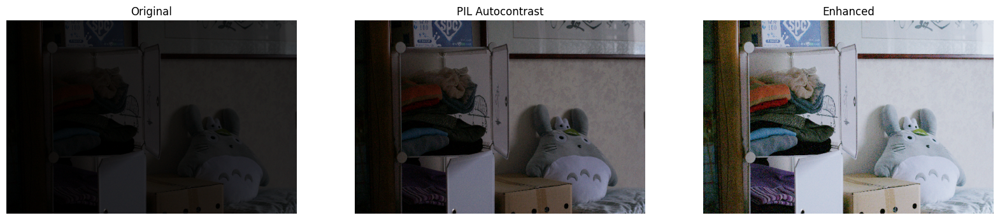

PSNR value: 28.665214390551448 dB


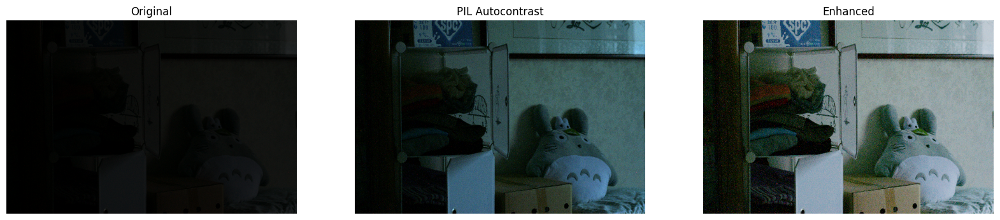

PSNR value: 28.703292111965606 dB


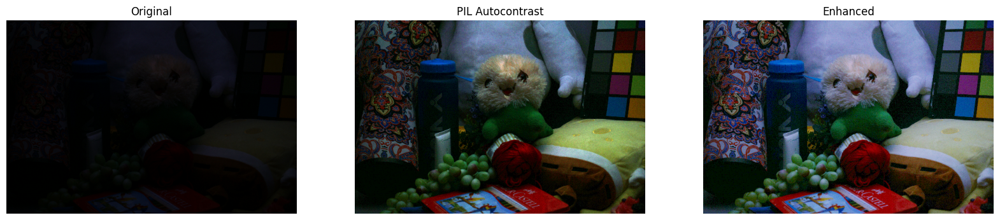

PSNR value: 28.243350134500883 dB


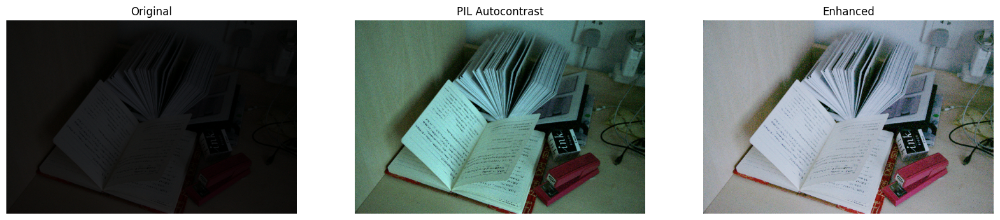

PSNR value: 28.715387147338696 dB


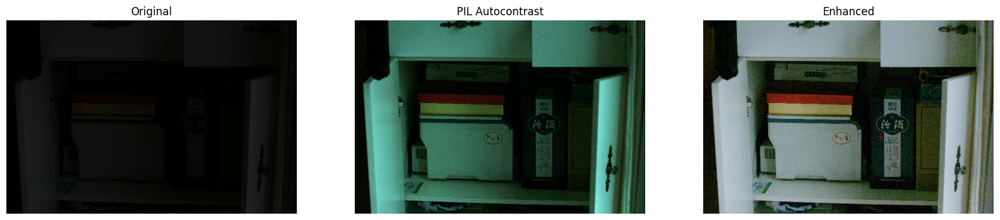

PSNR value: 28.93261605677505 dB


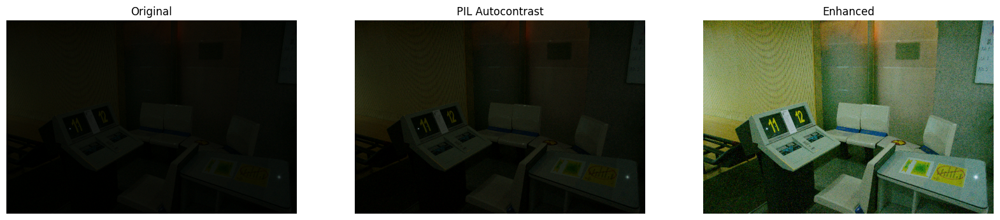

PSNR value: 28.349663835105314 dB


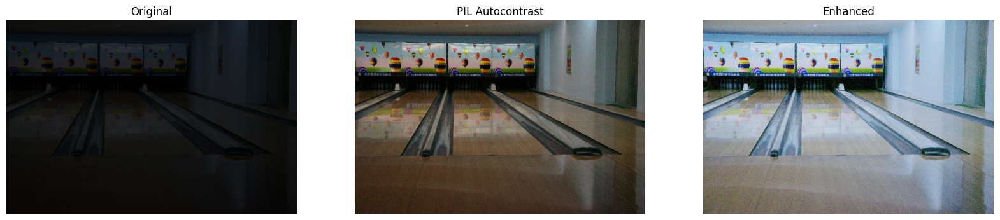

PSNR value: 28.693218764077997 dB


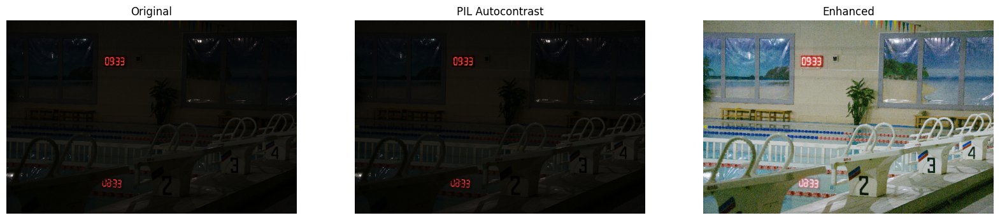

PSNR value: 28.726388726384783 dB


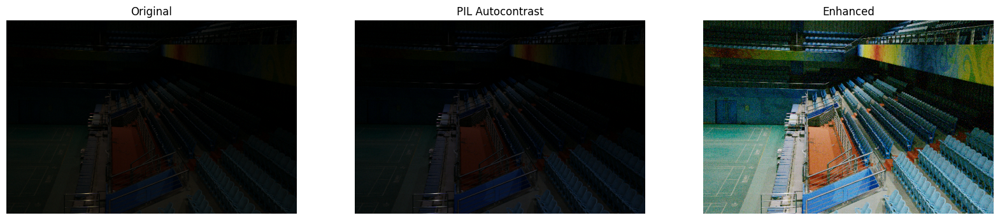

PSNR value: 28.764486708995225 dB


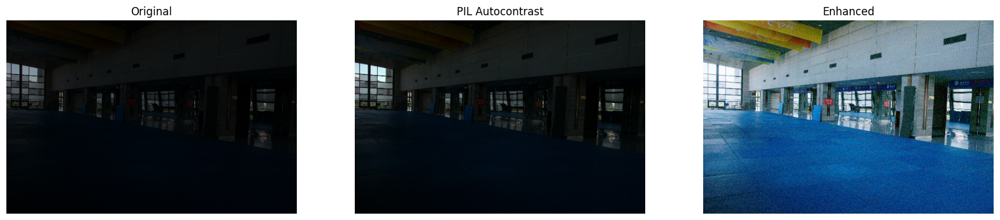

PSNR value: 27.711356611279363 dB


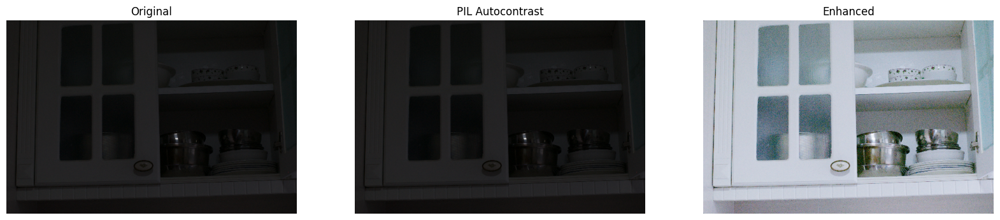

Mean PSNR value: 28.246882549447783 dB


In [27]:
def calculate_psnr(original, enhanced):
    mse = np.mean((np.array(original) - np.array(enhanced)) ** 2)
    max_pixel = 255.0
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

# Function to calculate mean PSNR
def calculate_mean_psnr(psnr_values):
    return np.mean(psnr_values)

# Initialize a list to store PSNR values
psnr_values_list = []

for val_image_file in test_low_light_images:
    original_image = Image.open(val_image_file)
    enhanced_image = infer(original_image)
    psnr_value = calculate_psnr(original_image, enhanced_image)
    psnr_values_list.append(psnr_value)
    print(f"PSNR value: {psnr_value} dB")
    plot_results(
        [original_image, ImageOps.autocontrast(original_image), enhanced_image],
        ["Original", "PIL Autocontrast", "Enhanced"],
        (20, 12),
    )

# Calculate mean PSNR
mean_psnr = calculate_mean_psnr(psnr_values_list)
print(f"Mean PSNR value: {mean_psnr} dB")

# ***Mean PSNR value :***

# ***28.24***